In [1]:
import os
import pdb
import pickle
import multiprocessing

import pandas as pd
import numpy as np

from tqdm import tqdm
from tensorflow import keras
from scipy.signal import lfilter
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns

sns.set()


# RNN Random vs ARMA

#### In this notebook, we experiment on using a Recurrent Neural Network (RNN) classifier to diferentiate between uncorrelated iid white Gaussian noise (WGN) signals and signals with a correlation structure (ARMA process). Questions we want to investigate are: is this feasible with good performance? Do AR and MA coefficients for a particular ARMA process interfere with the ability of the RNN model to detect its correlation structure? If so, how?

#### Notebook is structured as follows:
#### - Section 1 creates or reads labeled WGN/ARMA dataset;
#### - Section 2 pre-processes and splits WGN/ARMA dataset to be compatible with RNN model;
#### - Section 3 trains new model or loads previously trained RNN model;
#### - Section 4 creates a new test dataset and explores model performance with respect to AR and MA coefficients for ARMA signals;

## 1. Create or read data

In [2]:
def create_arma(arr):
    ma_coeffs = np.random.uniform(MA_RANGE[0],
                                  MA_RANGE[1],
                                  MA_ORDER+1)
    
    # Let's generate random ar coeffs whilst ensuring stability
    stable_ar=False
    while not stable_ar:
        ar_coeffs = np.random.uniform(AR_RANGE[0],
                                      AR_RANGE[1],
                                      AR_ORDER+1)
        # An AR system will be stable if and only if the roots
        # of the coefficient polynomial are all inside the unit circle
        ar_roots = np.roots(ar_coeffs)
        stable_ar = np.all(np.abs(ar_roots)<1)

    filtered_sig = lfilter(
        b=ma_coeffs,
        a=ar_coeffs,
        x=arr
    )
        
    return (filtered_sig-np.mean(filtered_sig))/np.std(filtered_sig)


def concatenate_arma(split_arr):
    filtered = np.empty(shape=(0,))
    for point in split_arr:
        filtered = np.concatenate(
            (filtered,create_arma(point))
        )
    filtered = filtered.reshape(((N_POINTS//2)//os.cpu_count(),SEQUENCE_LEN))
    return filtered

def create_dataset():
    # Create random noise sequences and filtered sequences
    random_points = np.random.normal(loc=0,
                                     scale=1,
                                     size=(N_POINTS//2,SEQUENCE_LEN))
    
    # Let's split the arrays for parallel processing
    split_arrays = np.array_split(random_points, os.cpu_count())

    # Execute parallel processing
    pool = multiprocessing.Pool(os.cpu_count())
    results = pool.map(concatenate_arma, split_arrays)
    
    # Let's concatenate each worker's individual result
    filtered = np.empty(shape=(0,SEQUENCE_LEN))
    for filtered_split in results:
        filtered = np.concatenate(
            (filtered,filtered_split)
        )
    
    # Concat random to filtered to create dataset
    dataset = np.concatenate(
            (random_points,filtered)
    )
    labels = np.concatenate(
            (np.zeros(random_points.shape[0]),np.ones(filtered.shape[0]))
    )
    return dataset,labels

In [3]:
%%time
CREATE_DATA = False
DATASET_PATH = './outputs/dataset_random_corr/dataset.pkl'
LABELS_PATH = './outputs/dataset_random_corr/labels.pkl'

SEQUENCE_LEN = 50
N_POINTS = 100000

# Setup params for ARMA process generation
MA_ORDER = 2
AR_ORDER = 2
MA_RANGE = [-2,2]
AR_RANGE = [-2,2]


if CREATE_DATA:
    # Generate data
    dataset, labels = create_dataset()
    
    # Write data
    with open(DATASET_PATH,'wb') as f:
        pickle.dump(dataset,f)
    with open(LABELS_PATH,'wb') as f:
        pickle.dump(labels,f)
        
else:
    # Read data
    with open(DATASET_PATH,'rb') as f:
        dataset = pickle.load(f)
    with open(LABELS_PATH,'rb') as f:
        labels = pickle.load(f)

CPU times: user 28.2 ms, sys: 133 ms, total: 161 ms
Wall time: 183 ms


## 2. Process and split data

In [4]:
def reshape_and_split(data_arr,labels_arr):
    
    # Let's reshape our data array and our labels array
    # for the RNN model
    data_arr = data_arr.reshape((N_POINTS,SEQUENCE_LEN,1))
    labels_arr = to_categorical(labels_arr)
    
    Xtrain, Xtest, ytrain, ytest = train_test_split(data_arr,
                                                    labels_arr,
                                                    train_size=TRAIN_FRAC,
                                                    shuffle=True)
    return Xtrain, Xtest, ytrain, ytest

In [5]:
TRAIN_FRAC = 0.7

X_train, X_test, y_train, y_test = reshape_and_split(dataset,labels)

## 3. Train model

In [6]:
def get_model():
    return keras.models.Sequential(
        [
            keras.layers.RNN(cell=RNN_CELL(units=RNN_UNITS),
                             input_shape=(SEQUENCE_LEN,1)),
            keras.layers.Dense(units=DENSE_UNITS),
            keras.layers.Dense(units=2,activation='softmax')
        ]
    )

def train_and_evaluate(Xtrain, Xtest, ytrain, ytest):
    model = get_model()
    print(model.summary())
    
    model.compile(optimizer='adam',
                  loss=keras.losses.categorical_crossentropy,
                  metrics=['accuracy'])
    
    early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss',
                                                   patience=10,
                                                   restore_best_weights=True)
    csv_logger = keras.callbacks.CSVLogger(HISTORY_PATH)
    history = model.fit(x=Xtrain,
                        y=ytrain,
                        batch_size=BATCH_SIZE,
                        epochs=N_EPOCHS,
                        validation_data=(Xtest,ytest),
                        callbacks=[early_stopping,csv_logger])
    
    return model

In [7]:
RNN_UNITS=32
RNN_CELL = keras.layers.SimpleRNNCell
DENSE_UNITS=32
BATCH_SIZE=1000
N_EPOCHS=500

MODEL_PATH = './outputs/models_random_corr/model.h5'
HISTORY_PATH = './outputs/models_random_corr/history.csv'
TRAIN=False

if TRAIN:
    model = train_and_evaluate(X_train, X_test, y_train, y_test)
    model.save(MODEL_PATH)
else:
    model = keras.models.load_model(MODEL_PATH)
    print(model.summary())
history = pd.read_csv(HISTORY_PATH)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rnn_4 (RNN)                  (None, 32)                1088      
_________________________________________________________________
dense_8 (Dense)              (None, 32)                1056      
_________________________________________________________________
dense_9 (Dense)              (None, 2)                 66        
Total params: 2,210
Trainable params: 2,210
Non-trainable params: 0
_________________________________________________________________
None


In [8]:
def plot_history(history):
    fig = plt.figure(figsize = (15,15))
    spec = gridspec.GridSpec(ncols=1, nrows=2, figure=fig)
    f_ax1 = fig.add_subplot(spec[0, 0])
    f_ax2 = fig.add_subplot(spec[1, 0])

    # Plot 1
    f_ax1.plot(history['epoch'],history['loss'],label='loss')
    f_ax1.plot(history['epoch'],history['val_loss'],label='val_loss')
    f_ax1.legend(fontsize=15)
    f_ax1.set_title('Loss',fontsize=15)
    f_ax1.set_xlabel('Epoch',fontsize=15)

    # Plot 1
    f_ax2.plot(history['epoch'],history['accuracy'],label='accuracy')
    f_ax2.plot(history['epoch'],history['val_accuracy'],label='val_accuracy')
    f_ax2.legend(fontsize=15)
    f_ax2.set_title('Accuracy',fontsize=15)
    f_ax2.set_xlabel('Epoch',fontsize=15)

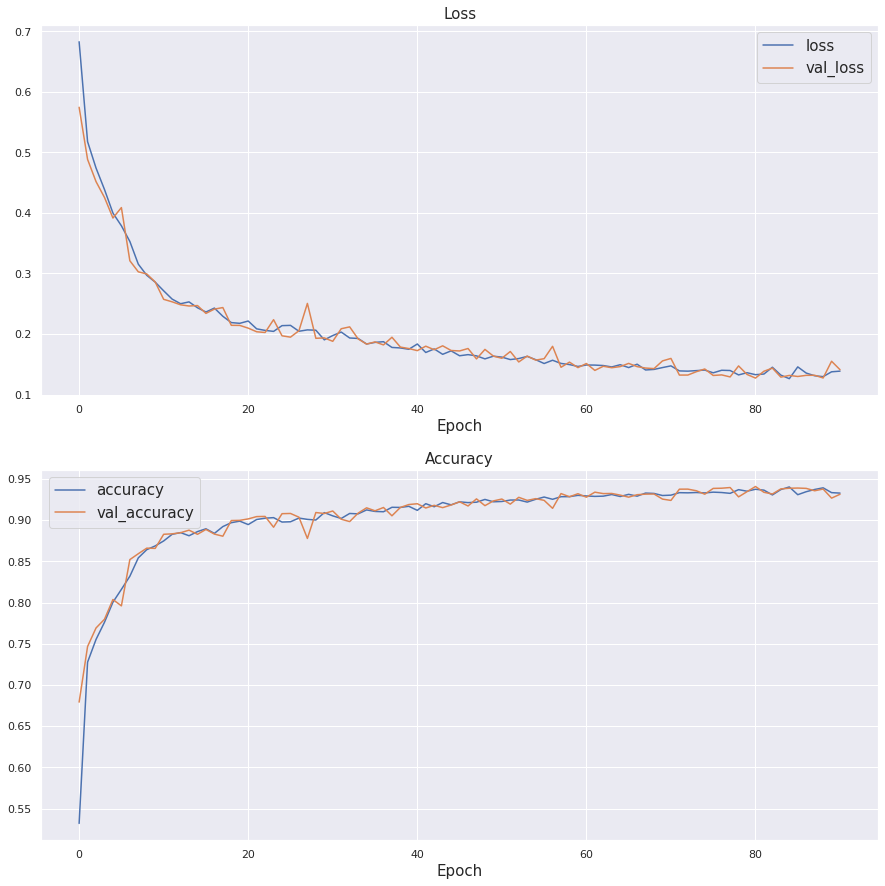

In [9]:
plot_history(history)

# 4. Test model

#### In this section, we create a dataset with new unseen samples by the model, and also log what were the AR and MA coefficients used for obtaining each ARMA signal. This will be necessary to later explore how the model responds to AR and MA coefficients.

## 4.1. Get test dataset and stats

In [23]:
def create_arma_test(arr):
    ma_coeffs = np.random.uniform(MA_RANGE[0],
                                  MA_RANGE[1],
                                  MA_ORDER+1)
    # Let's generate random ar coeffs whilst ensuring stability
    stable_ar=False
    while not stable_ar:
        ar_coeffs = np.random.uniform(AR_RANGE[0],
                                      AR_RANGE[1],
                                      AR_ORDER+1)
        # An AR system will be stable if and only if the roots
        # of the coefficient polynomial are all inside the unit circle
        ar_roots = np.roots(ar_coeffs)
        stable_ar = np.all(np.abs(ar_roots)<1)
        
    normalized_ma_coeffs = ma_coeffs/ma_coeffs[0]
    normalized_ar_coeffs = ar_coeffs/ar_coeffs[0]

    filtered_sig = lfilter(
        b=ma_coeffs,
        a=ar_coeffs,
        x=arr
    )

    return (
        (filtered_sig-np.mean(filtered_sig))/np.std(filtered_sig),
        np.linalg.norm(ma_coeffs),
        normalized_ma_coeffs[1],
        normalized_ma_coeffs[2],
        np.linalg.norm(ar_coeffs),
        normalized_ar_coeffs[1],
        normalized_ar_coeffs[2]
    )


def get_classification_results(df):
    
    df['detection_result'] = ''
    for i, row in df.iterrows():
        corr_label = row['label']
        predicted_label = row['predicted_label']
        if corr_label==1:
            if predicted_label==1:
                df.at[i,'detection_result']='true_positive'
            if predicted_label==0:
                df.at[i,'detection_result']='false_negative'
        if corr_label==0:
            if predicted_label==1:
                df.at[i,'detection_result']='false_positive'
            if predicted_label==0:
                df.at[i,'detection_result']='true_negative'
                
    return df


def get_confusion_matrix(df):

    results = df.pivot_table(
        values='label',
        columns='detection_result',
        aggfunc=lambda x:len(x)
    )
    for col in ['true_positive','false_negative','false_positive','true_negative']:
        if col not in results.columns:
            results[col]=0
    
    conf_mat = pd.DataFrame(
        index = ['real_0','real_1'],
        data = {
            'predicted_0':[results['true_negative'].iloc[0],
                           results['false_negative'].iloc[0]],
            'predicted_1':[results['false_positive'].iloc[0],
                           results['true_positive'].iloc[0]]
        }
    )
    
    acc = (results['true_negative'] + results['true_positive'])/results.sum(axis=1)
    prec = results['true_positive']/(results['true_positive']+results['false_positive'])
    recall = results['true_positive']/(results['true_positive']+results['false_negative'])

    print('-'*75)
    print('Accuracy: {}%'.format(round(100*acc.iloc[0],2)))
    print('Precision: {}%'.format(round(100*prec.iloc[0],2)))
    print('Recall: {}%'.format(round(100*recall.iloc[0],2)))
    print('-'*75)
    print('Confusion matrix:')
    print(conf_mat)
    print('-'*75)
    
    return conf_mat

def filter_fn(arr):
    return np.array([create_arma_test(x) for x in arr])

def test_model():
    # Create random noise sequences filtered sequences
    random_points = np.random.normal(loc=0,
                                     scale=1,
                                     size=(N_TEST_POINTS//2,SEQUENCE_LEN))
    
    # Get filtered sequences and coefficient vector norms with parallel execution
    # filter_fn = lambda x: np.array([create_arma_test(arr) for arr in x])
    pool = multiprocessing.Pool(os.cpu_count())
    results = pool.map(
        filter_fn,
        np.array_split(random_points,os.cpu_count())
    )
    
    # Let's concatenate each worker's individual result
    results_agg = np.empty(shape=(0,7))
    for filtered_split in results:
        results_agg = np.concatenate(
            (results_agg,filtered_split)
        )
        
    # Let's separate different coefficients
    filtered = np.array([arr for arr in results_agg[:,0]])
    ma_norm = results_agg[:,1]
    ma_1 = results_agg[:,2]
    ma_2 = results_agg[:,3]
    ar_norm = results_agg[:,4]
    ar_1 = results_agg[:,5]
    ar_2 = results_agg[:,6]
    # Concat to create dataset
    dataset = np.concatenate(
            (random_points,filtered)
    )
    labels = np.concatenate(
            (np.zeros(random_points.shape[0]),np.ones(filtered.shape[0]))
    )
    
    # Create predictions and decide on class probabilities
    predictions = model.predict(dataset.reshape((N_TEST_POINTS,SEQUENCE_LEN,1)))
    probs_0 = [x[0] for x in predictions]
    probs_1 = [x[1] for x in predictions]
    decisions = [np.argmax(x) for x in predictions]
    
    # Create dataframe with information
    test_results = pd.DataFrame(data={
        'label':labels,
        'prob_0':probs_0,
        'prob_1':probs_1,
        'predicted_label':decisions,
        'ma_norm':random_points.shape[0]*[np.nan]+list(ma_norm),
        'ma_1':random_points.shape[0]*[np.nan]+list(ma_1),
        'ma_2':random_points.shape[0]*[np.nan]+list(ma_2),
        'ar_norm':random_points.shape[0]*[np.nan]+list(ar_norm),
        'ar_1':random_points.shape[0]*[np.nan]+list(ar_1),
        'ar_2':random_points.shape[0]*[np.nan]+list(ar_2)
    })
    
    # Get classification status for each prediction
    test_results = get_classification_results(test_results)
    
    # Get confusion matrix
    conf_mat = get_confusion_matrix(test_results)
    
    return test_results, conf_mat


In [24]:
N_TEST_POINTS = 50000
test_results, confusion_matrix = test_model()
test_results.sample(10)

---------------------------------------------------------------------------
Accuracy: 94.16%
Precision: 94.79%
Recall: 93.46%
---------------------------------------------------------------------------
Confusion matrix:
        predicted_0  predicted_1
real_0      23716.0       1284.0
real_1       1634.0      23366.0
---------------------------------------------------------------------------


,label,prob_0,prob_1,predicted_label,ma_norm,ma_1,ma_2,ar_norm,ar_1,ar_2,detection_result
40646,1.0,3.633543e-05,0.999964,1,2.568460,1.221868,-1.500196,1.953847,0.381335,-0.318307,true_positive
44099,1.0,1.482668e-02,0.985173,1,2.404630,-0.808828,-0.773375,2.147677,0.659813,0.080201,true_positive
38337,1.0,3.930068e-04,0.999607,1,1.358825,-0.780080,-0.566668,2.241605,1.028500,0.493852,true_positive
11586,0.0,9.999831e-01,0.000017,0,NaN,NaN,NaN,NaN,NaN,NaN,true_negative
8356,0.0,9.997389e-01,0.000261,0,NaN,NaN,NaN,NaN,NaN,NaN,true_negative
36121,1.0,1.126344e-05,0.999989,1,2.227505,-2.294576,-0.733480,1.259801,-0.006299,0.927592,true_positive
41440,1.0,5.475391e-07,0.999999,1,1.012928,-50.311162,-34.745276,2.468178,-0.920381,0.358338,true_positive
14150,0.0,9.999824e-01,0.000018,0,NaN,NaN,NaN,NaN,NaN,NaN,true_negative
49881,1.0,1.358827e-03,0.998641,1,2.441609,0.714102,0.758872,1.176550,-0.059765,0.777784,true_positive
39958,1.0,1.492314e-03,0.998508,1,2.074254,-3.521883,0.138986,2.079074,-0.374445,-0.545695,true_positive


#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
### Here, it is interesting to point out that model accuracy is close to the one obtained in the validation set whilst training. Also, precision and recall are similar.
#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

## 4.1 Global size of AR and MA coefficients

In [91]:
def plot_joint_arma_norm(df):
    
    # Create figure and axes using GridSpec
    fig = plt.figure(figsize=(20,10))
    spec = gridspec.GridSpec(ncols=2, nrows=1, figure=fig)
    ax1 = fig.add_subplot(spec[0, 0])
    ax2 = fig.add_subplot(spec[0, 1])

    # sns.pairplot(
    #     data=df,
    #     x_vars = ['ma_norm','ar_norm'],
    #     y_vars = ['ma_norm','ar_norm'],
    #     hue='detection_result'
    # )

    # High prob_1
    sns.scatterplot(
        data=df[
            df.prob_1 > 0.7
        ],
        x='ar_norm',
        y='ma_norm',
        hue='prob_1',
        palette='crest',
        ax=ax1
    )
    ax1.set_title('prob_1 > 0.7')

    # Lower prob_1
    sns.scatterplot(
        data=df[
            df.prob_1 < 0.7
        ],
        x='ar_norm',
        y='ma_norm',
        hue='prob_1',
        ax=ax2
    )
    ax2.set_title('prob_1 < 0.7')

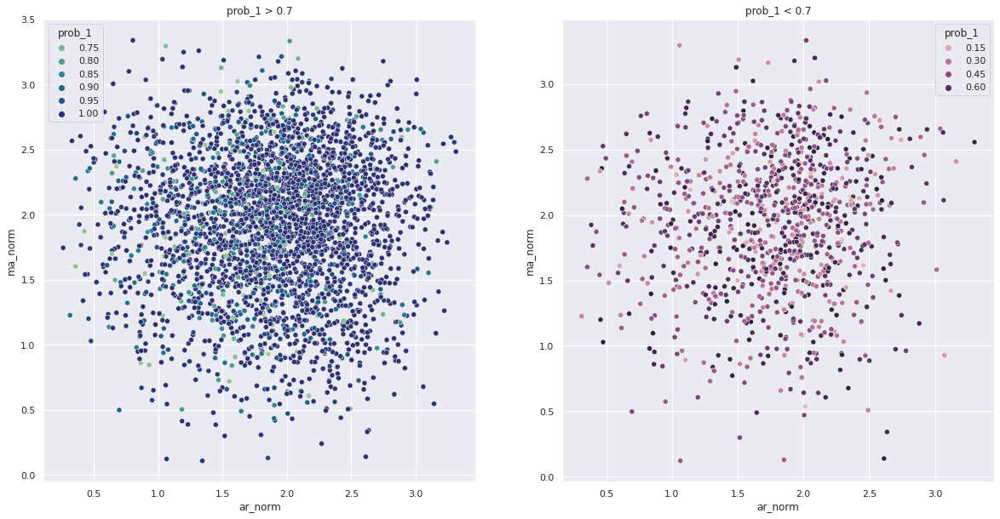

In [93]:
plot_joint_arma_norm(
    df=test_results[
        test_results['detection_result'].isin(['true_positive','false_negative'])
    ]
)

#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
### For true-label ARMA processes, label 1 probability does not seem to be very correlated with MA or AR norm: the distribution is similar for samples that received very different label 1 probabilities. There isn't a visible tendency of probability being higher for higher or lower AR/MA norms. In the next section, we go a little deeper to look at not only general AR/MA norm, but at the relative size of AR(1) and AR(2) wrt AR(0), as well as MA(1) and MA(2) wrt MA(0).
#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

## 4.3. Study predictions with respect to MA and AR coefficients for ARMA signals - isolated coefficient effects
#### In this section, we take a look at the relative size of AR(1) and AR(2) wrt AR(0), as well as MA(1) and MA(2) wrt MA(0), and how they relate to label 1 probability.

In [12]:
def plot_probs_ma_ar(df,plot_thresh=True):
    
    # Create figure and axes using GridSpec
    fig = plt.figure(figsize=(30,20))
    spec = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)
    ax1 = fig.add_subplot(spec[0, 0])
    ax2 = fig.add_subplot(spec[0, 1])
    ax3 = fig.add_subplot(spec[1, 0])
    ax4 = fig.add_subplot(spec[1, 1])
    
    thresh = 100*[0.5]
    
    # Axis 1 - ar(1)
    sns.scatterplot(
        data=df,
        x='ar_1',
        y='prob_1',
        ax=ax1,
        hue='detection_result'
    )
    if plot_thresh:
        ar1_thresh_x = np.linspace(
            start=df['ar_1'].min(),
            stop=df['ar_1'].max(),
            num=100
        )
        ax1.plot(
            ar1_thresh_x,
            thresh,
            linewidth=2,
            linestyle='--',
            color='red',
            label='decision_thresh'
        )
        ax1.legend(fontsize=15)

    # Axis 2 - ar(2)
    sns.scatterplot(
        data=df,
        x='ar_2',
        y='prob_1',
        ax=ax2,
        hue='detection_result'
    )
    if plot_thresh:
        ar2_thresh_x = np.linspace(
            start=df['ar_2'].min(),
            stop=df['ar_2'].max(),
            num=100
        )
        ax2.plot(
            ar2_thresh_x,
            thresh,
            linewidth=2,
            linestyle='--',
            color='red',
            label='decision_thresh'
        )
        ax2.legend(fontsize=15)
    

    # Axis 3 - ma(1)
    sns.scatterplot(
        data=df,
        x='ma_1',
        y='prob_1',
        ax=ax3,
        hue='detection_result'
    )
    ax3.set_xlim(-5,5)
    if plot_thresh:
        ma1_thresh_x = np.linspace(
            start=-5,
            stop=5,
            num=100
        )
        ax3.plot(
            ma1_thresh_x,
            thresh,
            linewidth=2,
            linestyle='--',
            color='red',
            label='decision_thresh'
        )
        ax3.legend(fontsize=15)

    # Axis 4 - ar(2)
    sns.scatterplot(
        data=df,
        x='ma_2',
        y='prob_1',
        ax=ax4,
        hue='detection_result'
    )
    ax4.set_xlim(-5,5)
    if plot_thresh:
        ma2_thresh_x = np.linspace(
            start=-5,
            stop=5,
            num=100
        )
        ax4.plot(
            ma2_thresh_x,
            thresh,
            linewidth=2,
            linestyle='--',
            color='red',
            label='decision_thresh'
        )
        ax4.legend(fontsize=15)

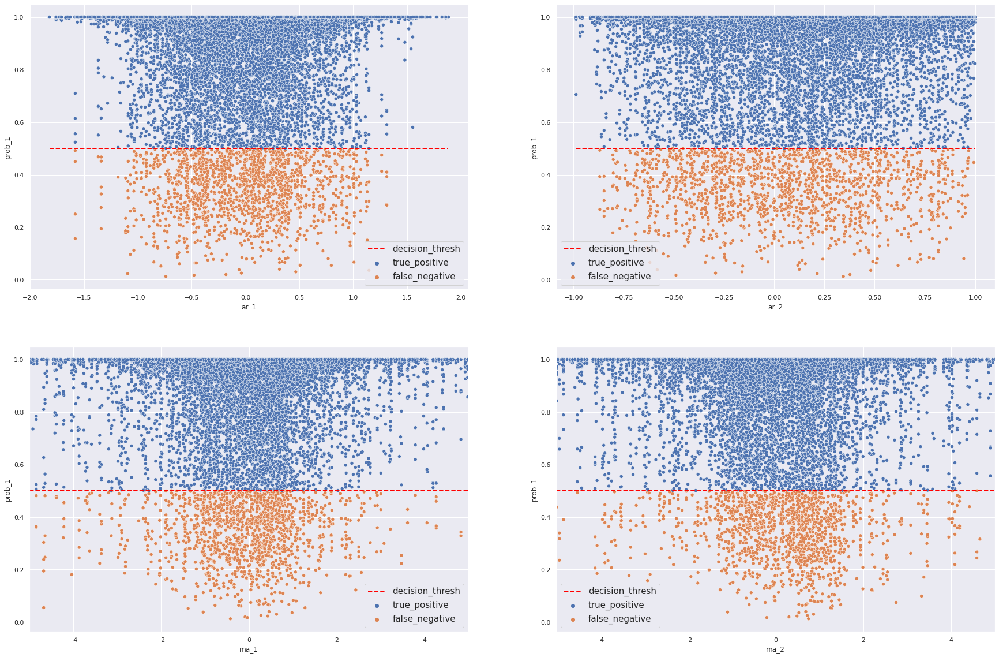

In [13]:
##########################################################################################
# Label 1 probability against AR(1), AR(2), MA(1) and MA(2), separated by classification #
# given by RNN.                                                                          #
##########################################################################################

plot_probs_ma_ar(test_results[test_results['detection_result'].isin(['true_positive','false_negative'])])

In [94]:
def plot_probs_per_quantile(df,quants):
    
    df['ar_1_abs'] = np.abs(df['ar_1'])
    df['ar_2_abs'] = np.abs(df['ar_2'])
    df['ma_1_abs'] = np.abs(df['ma_1'])
    df['ma_2_abs'] = np.abs(df['ma_2'])

    df['ar_1_quant'] = pd.qcut(df['ar_1_abs'],
                               q=quants,
                               labels=False)
    df['ar_2_quant'] = pd.qcut(df['ar_2_abs'],
                               q=quants,
                               labels=False)
    df['ma_1_quant'] = pd.qcut(df['ma_1_abs'],
                               q=quants,
                               labels=False)
    df['ma_2_quant'] = pd.qcut(df['ma_2_abs'],
                               q=quants,
                               labels=False)
    
    
    # Create figure and axes using GridSpec
    fig = plt.figure(figsize=(30,20))
    spec = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)
    ax1 = fig.add_subplot(spec[0, 0])
    ax2 = fig.add_subplot(spec[0, 1])
    ax3 = fig.add_subplot(spec[1, 0])
    ax4 = fig.add_subplot(spec[1, 1])

    # Axis 1 - ar(1)
    sns.boxenplot(
        data=df,
        x='ar_1_quant',
        y='prob_1',
        ax=ax1,
    )

    # Axis 2 - ar(2)
    sns.boxenplot(
        data=df,
        x='ar_2_quant',
        y='prob_1',
        ax=ax2
    )


    # Axis 3 - ma(1)
    sns.boxenplot(
        data=df,
        x='ma_1_quant',
        y='prob_1',
        ax=ax3,
    )

    # Axis 4 - ma(2)
    sns.boxenplot(
        data=df,
        x='ma_2_quant',
        y='prob_1',
        ax=ax4,
    )
    

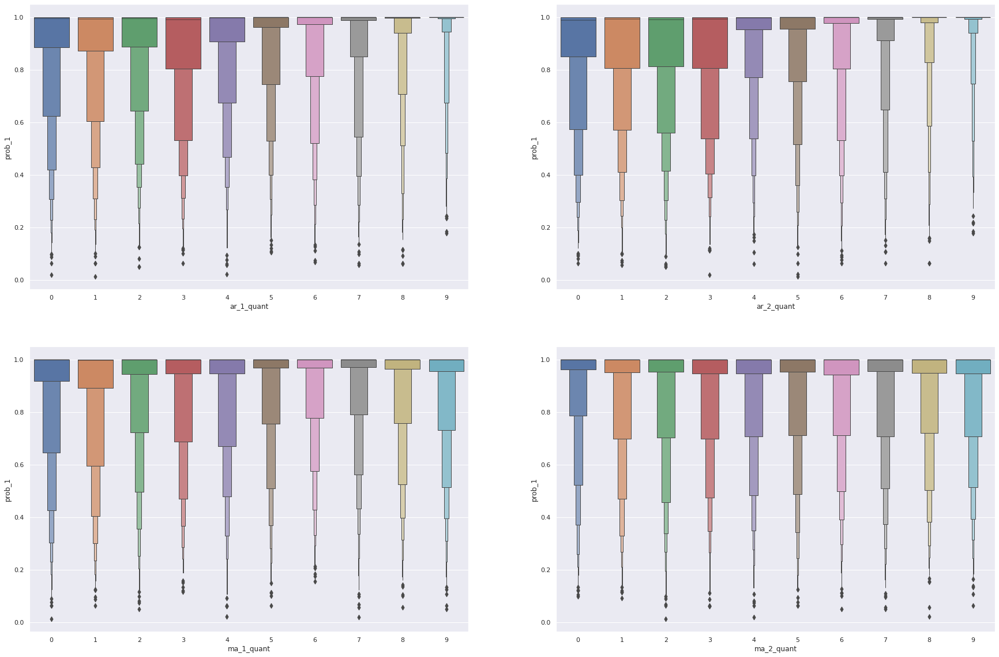

In [95]:
########################################################################################
# Label 1 probability per decile of absolute value of of AR(1), AR(2), MA(1) and MA(2) #
######################################################################################## 

plot_probs_per_quantile(
    df=test_results[
        test_results['detection_result'].isin(['true_positive','false_negative'])
    ],
    quants=10
)

#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
### In both diagrams, we do see what seems to be a higher sensibility to AR(1) and AR(2) when compared do MA(1) and MA(2). This is especially made clear by the boxenplots: as we go up on AR(1)/AR(2) quantiles (greater absolute values of AR(1)/AR(2)), there is a higher concentration of probability values near 1. This is not the case for MA(1) and MA(2) coefficients, as for these the label 1 probability distributions are homogeneous throughout the quantiles. This is also visible in the scatter plots: number of points with lower label 1 probability decreases as AR coefficients are made larger in absolute value (more positive or more negative). This is much less the case when we consider MA coefficients.

### However, both plots show that there is a lot dispersion of label 1 probability with respect to AR(1)/AR(2)/MA(1)/MA(2), there being a reasonable amount of points for each coefficient where one has a small value for the coefficient itself whilst having a large label 1 probability. As we have seen that a general correlation between either AR or MA general norm and label 1 probability is not noticeable either, one may conclude that, in large part, the predictions made by the RNN are governed by high-level features which do not necessarily manifest in intuitive AR/MA coefficients.
#### -----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------